<div style=" text-align: center; justify-content: center; align-items: center; background-color: #5AE78F; padding: 10px;  border-radius: 10px;">
    <h1 style="color: black;  margin-top: 9px; margin-bottom: 9px; "><center>
        Kickstarter Projects | Analysis + Predictions 📈
</center></h1>
</div>

<center>
        <img src="https://www.crowdcrux.com/wp-content/uploads/2021/03/preview-lightbox-Friday-Blogpost_Kickstarter.png" width=500>
</center>

-------------------------
# Introduction 📖

Kickstarter, founded in 2009, revolutionized crowdfunding by connecting creators with supporters worldwide. In this analysis, we explore Kickstarter projects with a focus on predicting their success before launch. This predictive insight empowers creators, ensuring their ideas have a higher chance of success from the outset.

----------------------------
# Table of Contents 📑 

> - [1 - Import Libraries 📚](#1)
> - [2 - Data Exploration 🔎](#2)
> - [3 - Exploratory Data Analysis 📊](#3)
>    - [3.1- Univariate Analysis](#3.1)
>    - [3.2- Bivariate Analysis](#3.2)
> - [4 - Data Preprocessing ⚒️](#4)
>    - [4.1- Feature Extraction](#4.1)
>    - [4.2- Handling Missing Data](#4.2)
>    - [4.3- Handling Outliers](#4.3)
>    - [4.4- Handling Categorical Data](#4.4)
>    - [4.5- Data Split to Train and Test Sets](#4.5)
>    - [4.6- Building a Machine Learning Pipeline (Data Encoding And Scaling)](#4.6)
> - [5- Models Training and Evaluation ⚙️](#5)
>    - [5.1- K-fold Cross-Validation Evaluation and Feature Selection](#5.1)
>    - [5.2- Training the Chosen Model (LightGBM)](#5.2)
> - [6- Hyperparameter Tuning 🛠️](#6)
>    - [6.1- ROC Curve for Final Model (LGBMClassifier)](#6.1)
> - [7- Model Deployment💡](#7)

---------------------------------------
<a class="anchor"  id="1"></a>
# 1- Import Libraries 📚

In [1]:
# EDA Libraries
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import plotly.subplots as sp
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt
import pycountry
sns.set_style("whitegrid")

# Data Preprocessing Libraries
from datasist.structdata import detect_outliers
from sklearn.model_selection import train_test_split, StratifiedKFold, cross_validate
from sklearn.preprocessing import StandardScaler, OneHotEncoder, RobustScaler
from category_encoders import BinaryEncoder
from datasist.structdata import detect_outliers
from sklearn.impute import SimpleImputer
from imblearn.over_sampling import SMOTE

# Machine Learing (classification models) Libraries
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.feature_selection import SequentialFeatureSelector, SelectKBest, f_regression, RFE, SelectFromModel
from imblearn.pipeline import Pipeline 
from sklearn.compose import ColumnTransformer
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score, classification_report, roc_curve, roc_auc_score 
import lightgbm as lgb
import xgboost as xgb
from sklearn.model_selection import GridSearchCV

# Model Deployment Libraries
import joblib as jb
import streamlit as st

-------------------
<a class="anchor"  id="2"></a>
# 2- Data Exploration 🔎

In [2]:
df = pd.read_csv("ks-projects-201801.csv")

df.shape

(378661, 15)

In [3]:
# Working with 100,000 rows due to the large dataset size, ensuring efficient model development and testing.
df= df.sample(100000, random_state=42).reset_index().drop('index', axis=1)

df.sample(10)

,ID,name,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real
83081,1732210843,Tri-State Comics,Illustration,Art,USD,2016-03-26,150.0,2016-02-25 18:44:52,0.00,failed,0,US,0.00,0.00,150.00
98041,303631170,The Storytelling Box,Games,Games,USD,2016-04-19,1000.0,2016-03-19 23:34:26,12.00,failed,3,US,12.00,12.00,1000.00
97454,657634272,"Very Goods, the new Svpply",Product Design,Design,USD,2014-07-21,50000.0,2014-06-27 17:03:07,62906.36,successful,1321,US,62906.36,62906.36,50000.00
19212,791636224,Kids for Global Peace (Canceled),Music Videos,Film & Video,USD,2014-06-14,60000.0,2014-05-15 21:03:13,126.00,canceled,3,US,126.00,126.00,60000.00
71935,918018866,Inkling Book,Illustration,Art,USD,2017-11-18,20000.0,2017-10-19 09:06:56,20203.00,successful,166,US,30.00,20203.00,20000.00
59510,651503772,Peachy-Keen Comic,Comics,Comics,USD,2011-03-01,3000.0,2011-01-11 02:54:33,4127.36,successful,58,US,4127.36,4127.36,3000.00
45884,1241670147,Treasure Hunt faith based family film,Family,Film & Video,USD,2017-05-20,40000.0,2017-04-20 18:32:11,1375.00,failed,5,US,75.00,1375.00,40000.00
84198,1431714676,Freckle Baby 2.0,Product Design,Design,USD,2016-05-02,5000.0,2016-04-01 06:02:55,5313.00,successful,110,US,5313.00,5313.00,5000.00
23951,1325049695,iheadbones Bone Conduction Bluetooth Wireless ...,Hardware,Technology,USD,2014-11-15,20000.0,2014-10-16 17:37:42,2450.00,suspended,15,US,2450.00,2450.00,20000.00
88615,2072936654,Pokemon VCG/TCG Fan Club,Video Games,Games,CAD,2016-04-30,6000.0,2016-03-24 03:00:05,1.00,failed,1,CA,0.77,0.78,4658.75


In [4]:
# Checking columns names
df.columns

Index(['ID', 'name', 'category', 'main_category', 'currency', 'deadline',
       'goal', 'launched', 'pledged', 'state', 'backers', 'country',
       'usd pledged', 'usd_pledged_real', 'usd_goal_real'],
      dtype='object')

### Feature Exploration

> - **`ID`**: Unique project identifier.
> - **`name`**: Project name.
> - **`category`**: Subcategory of the project.
> - **`main_category`**: Broad project category.
> - **`currency`**: Currency in which funding goal is stated.
> - **`deadline`**: Date project funding period ends.
> - **`goal`**:  Funding goal in project's currency.
> - **`launched`**: Date project was started.
> - **`pledged`**: Total amount pledged by backers.
> - **`state`**: Current project status (successful, failed, etc.).
> - **`backers`**: The number of individuals who have pledged money to support the project.
> - **`country`**: The country where the project creator is based.
> - **`usd pledged`**: Pledged amount converted to USD.
> - **`usd_pledged_real`**: Pledged amount in USD (normalized). This column provides a more accurate representation of the pledged amount in USD.
> - **`usd_goal_real`**: Funding goal in USD (normalized). This column provides a standardized representation of the funding goal in US Dollars.

In [5]:
# check the dataset shape
print("Number of Columns in data",df.shape[1])
print("---------------------------------------")
print("Number of Rows in data",df.shape[0])

Number of Columns in data 15
---------------------------------------
Number of Rows in data 100000


In [6]:
# data information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 15 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   ID                100000 non-null  int64  
 1   name              99998 non-null   object 
 2   category          100000 non-null  object 
 3   main_category     100000 non-null  object 
 4   currency          100000 non-null  object 
 5   deadline          100000 non-null  object 
 6   goal              100000 non-null  float64
 7   launched          100000 non-null  object 
 8   pledged           100000 non-null  float64
 9   state             100000 non-null  object 
 10  backers           100000 non-null  int64  
 11  country           100000 non-null  object 
 12  usd pledged       98995 non-null   float64
 13  usd_pledged_real  100000 non-null  float64
 14  usd_goal_real     100000 non-null  float64
dtypes: float64(5), int64(2), object(8)
memory usage: 11.4+ MB


- Need to drop ID and Name columns as they are unique identifier and not useful for predictions.
- usd pledged column has missing values and needs to be solved  
- launched column needs to be converted to datetime formate 

In [7]:
# Dropping ID and name columns as they are unique identifier and not useful for predictions.
df = df.drop(['ID', 'name'], axis=1)

In [8]:
# Checking if the columns has been dropped
df.head()

,category,main_category,currency,deadline,goal,launched,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real
0,Hardware,Technology,USD,2015-10-24,70000.0,2015-09-24 03:12:52,1888.0,failed,41,US,1888.00,1888.00,70000.00
1,Food Trucks,Food,USD,2015-02-01,250000.0,2015-01-02 20:55:07,1466.0,failed,9,US,1466.00,1466.00,250000.00
2,Food,Food,USD,2014-01-17,30000.0,2013-12-18 03:26:04,5723.0,failed,90,US,5723.00,5723.00,30000.00
3,Fiction,Publishing,GBP,2016-11-23,5500.0,2016-10-24 15:44:36,25.0,failed,2,GB,23.24,31.09,6839.01
4,Restaurants,Food,USD,2015-05-13,30000.0,2015-03-14 05:18:34,100.0,canceled,3,US,100.00,100.00,30000.00


In [9]:
# checking for duplicated values
df.duplicated().sum()

0

- Data dosen't contain anyduplicated value

In [10]:
# checking count the number of unique values in each column of the data
df.nunique()

category              159
main_category          15
currency               14
deadline             3084
goal                 3456
launched            99950
pledged             24113
state                   6
backers              2190
country                23
usd pledged         33414
usd_pledged_real    36711
usd_goal_real       19493
dtype: int64

## Simplifying Analysis
- I've converted the 'Country' column from codes to full names. This change makes it easier to understand and analyze the data effectively.

In [11]:
df['country'].unique()

array(['US', 'GB', 'ES', 'IT', 'CA', 'AU', 'DE', 'SG', 'NL', 'FR', 'HK',
       'IE', 'SE', 'N,0"', 'MX', 'BE', 'NZ', 'AT', 'CH', 'DK', 'NO', 'JP',
       'LU'], dtype=object)

In [12]:
# Function to convert country codes to full names
def get_country_name(code):
    try:
        return pycountry.countries.get(alpha_2=code).name
    except AttributeError:
        # Handle unknown or invalid country codes
        return "Unknown"

In [13]:
# Implementing the function on the 'country' column
df['country'] = df['country'].apply(lambda x: get_country_name(x))

In [14]:
df['country'].unique()

array(['United States', 'United Kingdom', 'Spain', 'Italy', 'Canada',
       'Australia', 'Germany', 'Singapore', 'Netherlands', 'France',
       'Hong Kong', 'Ireland', 'Sweden', 'Unknown', 'Mexico', 'Belgium',
       'New Zealand', 'Austria', 'Switzerland', 'Denmark', 'Norway',
       'Japan', 'Luxembourg'], dtype=object)

## Data Filtering: Selecting Relevant Project States

 - I noticed the 'state' variable had many options, but we're interested only in predicting 'failed' and 'successful' outcomes. So, i carefully filtered the data to include just these two. This helps us make more accurate predictions.

In [15]:
df['state'].value_counts()

failed        52057
successful    35410
canceled      10372
undefined       938
live            733
suspended       490
Name: state, dtype: int64

In [16]:
df = df[(df['state'] == 'failed') | (df['state'] == 'successful')]

In [17]:
df['state'].value_counts()

failed        52057
successful    35410
Name: state, dtype: int64

In [18]:
df.shape

(87467, 13)

In [19]:
# Descriptive analysis for categorical data
df.describe(include='O')

,category,main_category,currency,deadline,launched,state,country
count,87467,87467,87467,87467,87467,87467,87467
unique,159,15,14,3020,87430,2,23
top,Product Design,Film & Video,USD,2014-08-08,2014-10-28 16:46:59,failed,United States
freq,4967,14890,68983,155,2,52057,68940


In [20]:
# Descriptive analysis for numerical data
df.describe().style.background_gradient()

,goal,pledged,backers,usd pledged,usd_pledged_real,usd_goal_real
count,87467.000000,87467.000000,87467.000000,87408.000000,87467.000000,87467.000000
mean,38682.140664,10392.741121,117.930362,7629.229906,9878.320208,36824.626238
std,940375.200251,85220.162656,1149.548272,69731.874416,83715.380945,932321.111462
min,0.010000,0.000000,0.000000,0.000000,0.000000,0.010000
25%,2000.000000,50.000000,2.000000,25.000000,50.000000,2000.000000
50%,5000.000000,785.000000,15.000000,504.005000,792.000000,5000.000000
75%,15000.000000,4598.065000,62.000000,3415.000000,4557.500000,15000.000000
max,100000000.000000,8782571.990000,219382.000000,8782571.990000,8782571.990000,107369867.720000


-----------------------------------------
<a class="anchor"  id="3"></a>
# 3- Exploratory Data Analysis 📊

<a class="anchor"  id="3.1"></a>
## 3.1- Univariate Analysis

### Exploration: Categorical Features

In [21]:
fig = px.histogram(df, x='category', 
                   title='Category Distribution',
                   color_discrete_sequence=['#3498db'],  # Setting custom color
                   )

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

fig.show()

> According to the graph, the category with the highest count across all categories is "Product Design."

In [22]:
fig = px.histogram(df, x='main_category', 
                   title='Main category Distribution',
                   color_discrete_sequence=['#3498db'],  # Setting custom color
                  )

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

fig.show()

> According to the graph, the main category with the highest count across all main categories is "Film & Video"

In [23]:
fig = px.histogram(df, x='currency', 
                   title='Currency Distribution',
                   color_discrete_sequence=['#3498db'],  # Setting custom color
                   )

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

fig.show()

> The graph indicates that USD is the most commonly used currency for most projects.

In [24]:
fig = px.pie(df, names='state', 
             title='State Distribution',
             color_discrete_sequence=['#ff7f0e', '#3498db'],# Setting custom color
            )

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))


# Show the pie chart
fig.show()

> The pie plot reveals that the dataset contains a higher percentage of failed projects (59.5%) compared to successful projects (40.5%).

In [25]:
fig = px.histogram(df, x='country', 
                   title='Country Distribution',
                   color_discrete_sequence=['#3498db'],# Setting custom color
                   )
fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

fig.show()

> The graph highlights that the United States has the highest number of projects in the dataset.

### Exploration: Numerical Features

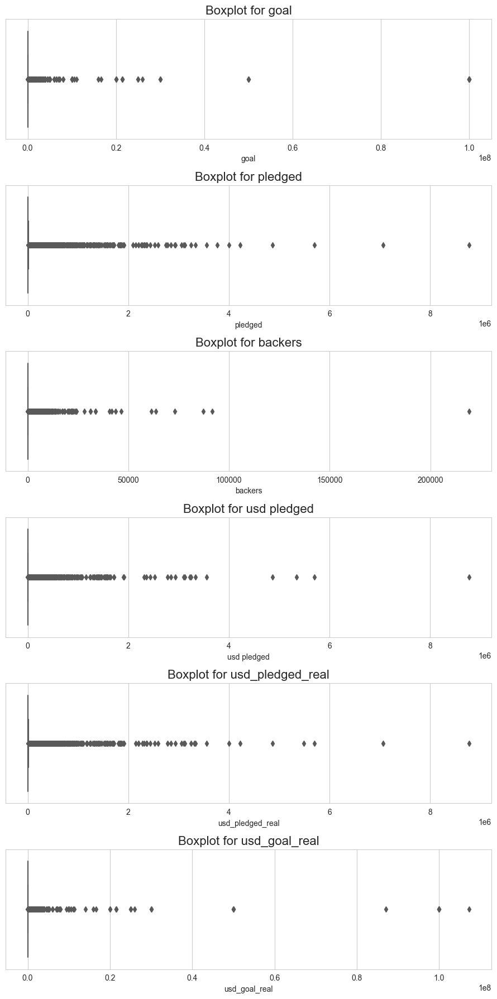

In [26]:
fig, axes = plt.subplots(6, 1, figsize=(9, 18))

numerical_features = [
   'goal','pledged', 'backers', 'usd pledged', 'usd_pledged_real', 'usd_goal_real'
]

#Looping through the subplots and create countplots for each feature
for i, ax in enumerate(axes.flat):
    if i < len(numerical_features):
        sns.boxplot(data=df, x=numerical_features[i], ax=ax, palette='Set2', orient='h')
        ax.set_title(f'Boxplot for {numerical_features[i]}', fontsize=16)
        
# Adjusting the layout for better visualization
plt.tight_layout()

plt.show()

> The boxplot for the numerical column shows the presence of significant outliers in the dataset. These outliers align with the overall trends of the dataset and are not data errors. However, to optimize our model, it is advisable to either remove or minimize these outliers.

---------------------------------------------
<a class="anchor"  id="3.2"></a>
## 3.2- Bivariate Analysis

### Which Top 10 categories have the highest and lowest success rates and failure rates ?

In [27]:
# Get top 10 categories in ascending order
top_categories = df['category'].value_counts().head(10).index

# Filter dataframe for top 10 categories
filtered_df = df[df['category'].isin(top_categories)]

# Filter data for successful and failed projects
successful_df = filtered_df[filtered_df['state'] == 'successful']
failed_df = filtered_df[filtered_df['state'] == 'failed']

# Count main categories for successful and failed projects
successful_category_counts = successful_df['category'].value_counts().sort_values(ascending=False)
failed_category_counts = failed_df['category'].value_counts().sort_values(ascending=False)

# Create subplots with 1 row and 2 columns
fig = make_subplots(rows=1, cols=2, subplot_titles=['Successful Projects', 'Failed Projects'])

# Add bar plot for successful projects
fig.add_trace(go.Bar(x=successful_category_counts.index, y=successful_category_counts.values, 
                     marker_color='#3498db', name='Successful Projects'), row=1, col=1)

# Add bar plot for failed projects
fig.add_trace(go.Bar(x=failed_category_counts.index, y=failed_category_counts.values, 
                     marker_color='#ff7f0e', name='Failed Projects'), row=1, col=2)

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# Update layout
fig.update_layout(title_text='Distribution of Top 10 Categories by Project State',
                  xaxis=dict(showgrid=False, zeroline=False),
                  yaxis=dict(showgrid=True, zeroline=False),
                  paper_bgcolor='rgb(233,233,233)',
                  plot_bgcolor='rgb(233,233,233)',
                  showlegend=False)

# Show the subplot
fig.show()

> "Looking at the top categories, 'Product Design' has many successful and unsuccessful projects, showing lots of activity. 'Tabletop Games' does really well with successful projects and doesn't fail much, making it a reliable choice. 'Shorts' also has a good track record with successful projects and not many failures, making it a promising option. These findings give helpful advice to people starting projects or investing."

### Which main categories have the highest and lowest success rates and failure rates ?

In [28]:
# Filter data for successful and failed projects
successful_df = df[df['state'] == 'successful']
failed_df = df[df['state'] == 'failed']

# Count main categories for successful and failed projects
successful_category_counts = successful_df['main_category'].value_counts().sort_values(ascending=False)
failed_category_counts = failed_df['main_category'].value_counts().sort_values(ascending=False)

# Create subplots with 1 row and 2 columns
fig = make_subplots(rows=1, cols=2, subplot_titles=['Successful Projects', 'Failed Projects'])

# Add bar plot for successful projects
fig.add_trace(go.Bar(x=successful_category_counts.index, y=successful_category_counts.values, 
                     marker_color='#3498db', name='Successful Projects'), row=1, col=1)

# Add bar plot for failed projects
fig.add_trace(go.Bar(x=failed_category_counts.index, y=failed_category_counts.values, 
                     marker_color='#ff7f0e', name='Failed Projects'), row=1, col=2)

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))


# Update layout
fig.update_layout(title_text='Distribution of Main Categories by Project State',
                  xaxis=dict(showgrid=False, zeroline=False),
                  yaxis=dict(showgrid=True, zeroline=False),
                  paper_bgcolor='rgb(233,233,233)',
                  plot_bgcolor='rgb(233,233,233)',
                  showlegend=False)

# Show the subplot
fig.show()

> "We found out that music projects do really well, they succeed a lot. Film & Video projects, on the other hand, don't always make it; they have a high chance of both failing and succeeding. This shows us that different types of projects within the same category can have very different results."

### Does the project's funding goal influence its outcome? 

In [29]:
# # Limit the DataFrame to a maximum of 10000 rows
limited_df = df.sample(min(10000, len(df)))

# Create a scatter plot using Plotly Express
fig = px.box(limited_df, x='state', y='goal', color='state',
                 title='Relationship between Project State and Funding Goal (Limited to 10000 Rows)',
                 color_discrete_sequence=['#ff7f0e', '#3498db'],
                 labels={'state': 'Project State', 'goal': 'Funding Goal'},
                 template='plotly_white')

fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the scatter plot
fig.show()

> "Projects with really big funding goals often fail. It's because they're very risky, and it's hard to get enough people to support such huge projects."

### Does a higher number of backers contribute to the success of a project?

In [30]:
fig = px.histogram(df, x='state', y='backers', color='state', title='Distribution of Backers by Project State',
                   labels={'state': 'Project State', 'backers': 'Number of Backers'},
                   color_discrete_sequence=['#ff7f0e', '#3498db']  
                   )

# Customizing layout: adjusting the gap between bars, marker appearance, gridlines, and title
fig.update_layout(
    bargap=0.1,
    xaxis_title='Project State',
    yaxis_title='Number of Backers'
)

# Customizing marker appearance
fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()

> "The graph illustrates a clear pattern: successful projects often attract a large number of backers. This occurs because substantial backer support enhances a project's likelihood of success."

### Do projects with more backers tend to receive higher usd pledged real?

In [31]:
fig = px.scatter(df, x='backers', y='usd_pledged_real', 
                color_discrete_sequence=['#3498db']) # Setting custom color

# Customizing marker appearance
fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

fig.show()

> The scatter plot reveals a positive correlation between backers and usd pledged real amounts. As the number of backers increases, the pledged amounts also rise, indicating a strong relationship between these variables.

### Does the country of origin influence the success or failure of a project?

In [32]:
fig = px.histogram(df, x='country', color='state',
             title='Success and Failure Rates by Country',
             labels={'country': 'Country', 'state': 'Project State'},
             template='plotly_white', barmode='group',
             color_discrete_sequence=['#ff7f0e', '#3498db']
            )

# Customizing marker appearance
fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()

> The United States has the most projects in our analysis, with the highest success and failure rates. This is because the US dollar (USD) is the most commonly used currency. The United States stands out, and other countries are not as significant in comparison.

In [33]:
# Grouping data by country and state, calculating success and failure counts
country_state_counts = df.groupby(['country', 'state']).size().unstack(fill_value=0)
country_state_counts['success_rate'] = country_state_counts['successful'] / (
    country_state_counts['successful'] + country_state_counts['failed'])

# Creating a choropleth map for success rate by country
fig = px.choropleth(country_state_counts, 
                    locations=country_state_counts.index,
                    locationmode="country names",
                    color='success_rate',
                    hover_name=country_state_counts.index,
                    color_continuous_scale=px.colors.sequential.Plasma,
                    title='Success Rate of Projects by Country',
                    labels={'success_rate': 'Success Rate'},
                    )

# Show the map
fig.show()

> The map displays differences in success rates among various countries.

------------------
<a class="anchor"  id="4"></a>
# 4- Data Preprocessing ⚒️

<a class="anchor"  id="4.1"></a>
## 4.1- Feature Extraction

## Extracting Time Components

> - Creating new columns **``day_launched``**, **``month_launched``**, **``year_launched``** for in-depth time analysis. 
> - Creating **``Project Duration``** in days column (Deadline - Launch Date) for further analysis
> - Creating **``Monthly Seasons``** column for a more detailed monthly breakdown.

In [34]:
# Transforming 'launched' column from text to date format to extract day, month and year. 
df['launched'] = pd.to_datetime(df['launched'])
df['deadline'] = pd.to_datetime(df['deadline'])

In [35]:
# "Extracting day, month, and year from 'launched' for detailed time analysis." time-based analysis.
df = df.assign( day_launched=df.launched.dt.day,
               month_launched=df.launched.dt.month,
               year_launched=df.launched.dt.year
              )

In [36]:
# Creating Project Duration in days (Deadline - Launch Date)
df['project_duration_days'] = (df['deadline'] - df['launched']).dt.days

In [37]:
# Creating a function to categorize months into seasons.
def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return 'Invalid Month'

In [38]:
# Creating Monthly Seasons column
df['monthly_seasons'] = df['month_launched'].apply(get_season)

In [39]:
# Dropping 'launched' and 'deadline' columns as they are not necessary for training our model.
df = df.drop(['launched', 'deadline'], axis=1)

In [40]:
df.head()

,category,main_category,currency,goal,pledged,state,backers,country,usd pledged,usd_pledged_real,usd_goal_real,day_launched,month_launched,year_launched,project_duration_days,monthly_seasons
0,Hardware,Technology,USD,70000.0,1888.0,failed,41,United States,1888.00,1888.00,70000.00,24,9,2015,29,Autumn
1,Food Trucks,Food,USD,250000.0,1466.0,failed,9,United States,1466.00,1466.00,250000.00,2,1,2015,29,Winter
2,Food,Food,USD,30000.0,5723.0,failed,90,United States,5723.00,5723.00,30000.00,18,12,2013,29,Winter
3,Fiction,Publishing,GBP,5500.0,25.0,failed,2,United Kingdom,23.24,31.09,6839.01,24,10,2016,29,Autumn
7,Plays,Theater,USD,3000.0,3506.0,successful,35,United States,3506.00,3506.00,3000.00,4,11,2014,39,Autumn


## EDA Continuation

### Has the success rate of launched projects changed over the years, months, and days?

In [41]:
# Grouping data by year and state, calculating success and failure counts
yearly_state_counts = df.groupby(['year_launched', 'state']).size().unstack(fill_value=0)
yearly_state_counts['success_rate'] = yearly_state_counts['successful'] / (yearly_state_counts['successful'] + yearly_state_counts['failed'])

# Creating a line plot for success rate and failure rate over the years
fig = px.line(yearly_state_counts, x=yearly_state_counts.index, y='success_rate',
              title='Success and Failure Rates of Projects Over the Years',
              color_discrete_sequence=['#1f77b4'])

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()

>  The success of projects started strong in 2011, then went down until 2015, and went up again in 2016. This happened because of market trends, project quality, and important events in history. These patterns help us plan for the future, showing the need to be flexible when things change.


In [42]:
# Grouping data by year and state, calculating success and failure counts
monthly_state_counts = df.groupby(['month_launched', 'state']).size().unstack(fill_value=0)
monthly_state_counts['success_rate'] = monthly_state_counts['successful'] / (monthly_state_counts['successful'] + monthly_state_counts['failed'])

# Creating a line plot for success rate and failure rate over the years
fig = px.line(monthly_state_counts, x=monthly_state_counts.index, y='success_rate',
              title='Success and Failure Rates of Projects Over the Months',
              color_discrete_sequence=['#1f77b4'])

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()

> Months from 2 to 5 and 10 to 11 have the best success rates, showing projects often succeed during these times. Month 7 (July), however, sees fewer successes, suggesting it's a tougher month. Factors like weather or holidays could impact these patterns.

In [43]:
# Grouping data by year and state, calculating success and failure counts
daily_state_counts = df.groupby(['day_launched', 'state']).size().unstack(fill_value=0)
daily_state_counts['success_rate'] = daily_state_counts['successful'] / (daily_state_counts['successful'] + daily_state_counts['failed'])

# Creating a line plot for success rate and failure rate over the years
fig = px.line(daily_state_counts, x=daily_state_counts.index, y='success_rate',
              title='Success and Failure Rates of Projects Over the Days',
              color_discrete_sequence=['#1f77b4'])

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()

> The success rate among different days doesn't follow a specific pattern; it varies across days

### Does the duration of the project (in days) impact its success or failure?

In [44]:
# Calculate success rate for different project durations
duration_success_rate = df.groupby('project_duration_days')['state'].apply(lambda x: (x == 'successful').mean()).reset_index()
duration_success_rate.columns = ['project_duration_days', 'Success Rate']

# Create a scatter plot for project duration vs. success rate
fig = px.scatter(duration_success_rate, x='project_duration_days', y='Success Rate',
                 title='Impact of Project Duration on Success Rate',
                 labels={'Project Duration (days)': 'Project Duration (days)', 'Success Rate': 'Success Rate'},
                 color_discrete_sequence=['#1f77b4']
                )

# Customizing marker appearance
fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()

> The graph shows that projects with shorter durations are more likely to succeed. Longer projects durations vary for each project, but overall, shorter durations are better for success.

### In which month do backers contribute the most to crowdfunding projects?

In [45]:
monthly_backers = df.groupby('monthly_seasons').agg({
    'backers': 'sum'
}).sort_values(by='backers', ascending=False)

# Creating a bar chart for monthly backers contribution
fig = px.bar(monthly_backers, x=monthly_backers.index, y='backers', 
             title='Monthly Seasons Backers Contribution to Crowdfunding Projects',
             color_discrete_sequence=['#1f77b4']
             )

# Customizing layout: adjusting the gap between bars, marker appearance, gridlines, and title
fig.update_layout(
    bargap=0.1,
    xaxis_title='Months',
    yaxis_title='Total Backers'
)

# Customizing marker appearance
fig.update_traces(marker=dict(line=dict(width=2, color='DarkSlateGrey')))

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)',
)

# Show the plot
fig.show()


> Spring and autumn have the highest backers' contribution, possibly due to favorable weather and cultural events. Summer follows closely, while winter shows the least contribution, suggesting seasonal factors influence backers' participation.

<a class="anchor"  id="4.2"></a>
## 4.2- Handling Missing Data

In [46]:
# checking for missing values in data
df.isna().sum() / df.shape[0]*100

category                 0.000000
main_category            0.000000
currency                 0.000000
goal                     0.000000
pledged                  0.000000
state                    0.000000
backers                  0.000000
country                  0.000000
usd pledged              0.067454
usd_pledged_real         0.000000
usd_goal_real            0.000000
day_launched             0.000000
month_launched           0.000000
year_launched            0.000000
project_duration_days    0.000000
monthly_seasons          0.000000
dtype: float64

> - **``usd pledged``** column contain missing data
> - Missing data will be addressed as part of the pipeline process.

<a class="anchor"  id="4.3"></a>
## 4.3- Handling Outliers

In [47]:
# Detect outliers in numerical features
outliers_indices = detect_outliers(df, features=numerical_features, n=0)
number_of_outliers = len(outliers_indices)

# Print the number of outliers
print(f'Number of outliers: {number_of_outliers}')

Number of outliers: 21640


In [48]:
# Removing all Outliers
df = df.drop(outliers_indices)

In [49]:
print(f"Dataset Shape After Removing Outliers {df.shape}")

Dataset Shape After Removing Outliers (65827, 16)


<a class="anchor"  id="4.4"></a>
## 4.4- Handling Categorical Data

- **Nominal**: Categories without a meaningful order or ranking like (**Category, Main Category, Currency, Country, Monthly Seasons**).
- **Ordinal**: Categories with a meaningful order or ranking like (**State**).

In [50]:
# Target encoding
targ_dic = {
             'failed': 0,
             'successful': 1 
            }

df['state'] = df['state'].map(targ_dic)

> The Nominal Features will be encoded through a pipline using one-hot encoding and binary encoding 

<a class="anchor"  id="4.5"></a>
## 4.5- Data Split to Train and Test Sets

In [51]:
# First we extract the x Featues and y Label
X = df.drop(['state'], axis=1)
y = df['state']

In [52]:
X.shape, y.shape

((65827, 15), (65827,))

In [53]:
# Then we Split the data into training and testing sets (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size=0.2, 
                                                    random_state=42, 
                                                    stratify=y
                                                   )

# Show the results of the split
print("Training set has {} samples.".format(X_train.shape[0]))
print("Testing set has {} samples.".format(X_test.shape[0]))

Training set has 52661 samples.
Testing set has 13166 samples.


In [54]:
y_train.value_counts(normalize=True)

0    0.647538
1    0.352462
Name: state, dtype: float64

> - We'll address the data imbalance by applying SMOTE within the pipeline. This ensures balanced data without loss, enhancing prediction quality for imbalanced datasets.

<a class="anchor"  id="4.6"></a>
## 4.6- Building a Machine Learning Pipeline (Data Encoding And Scaling)

> Making a good pipeline is really important for making our machine learning models work well. It not only helps the models perform better but also makes it easier to use them in real-world situations. It's like having a smooth road from creating the model to using it practically.

In [55]:
# Splitting columns into Categorical and Numerical Features

# "Define the categorical columns for binary encoding, excluding the target variable (state)."
categorical_features_be = [
    'category', 'main_category', 'currency', 'country'
]

# "Define the categorical columns for one-hot encoding, excluding the target variable (state)."
categorical_features_oh = [
    'monthly_seasons'
]

# Define the numerical column
# Year, month, and day are discarded during encoding as they represent specific timestamps, not ordinal values.
numerical_features = [
   'goal','pledged', 'backers', 'usd pledged', 'usd_pledged_real'
    ,'usd_goal_real', 'project_duration_days'
]

In [56]:
# Define a pipeline for numerical features: fill missing values with mean and scale the features
num_pipeline = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),  # Fill missing values with mean
    ('scaler', StandardScaler())  # Scale the features
])

# Define a pipeline for categorical features (Binary encode the features)
cat_pipeline_be = Pipeline(steps=[
    ('encoder', BinaryEncoder())  
])

# Define a pipeline for categorical features (one-hot encode the features)
cat_pipeline_oh = Pipeline(steps=[
    ('encoder', OneHotEncoder())  
])

# Combine numerical and categorical pipelines into a ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ('num', num_pipeline, numerical_features),  # Apply num_pipeline to numerical features
        ('cat_be', cat_pipeline_be, categorical_features_be), # Apply cat_pipeline_be to categorical features
        ('cat_oh', cat_pipeline_oh, categorical_features_oh) # Apply cat_pipeline_oh to categorical features
    ],
    remainder='passthrough'  # Passthrough other columns (if any)
)

--------------------------------------------------------
<a class="anchor"  id="5"></a>
# 5- Models Training and Evaluation ⚙️

In [57]:
# List of classifiers to evaluate
classifiers = [
    ("Logistic Regression", LogisticRegression(random_state=42, max_iter= 1500, n_jobs=-1)),
    ("Decision Tree", DecisionTreeClassifier(random_state=42)),
    ("Random Forest", RandomForestClassifier(random_state=42, n_jobs =-1)),
    ("AdaBoost", AdaBoostClassifier(random_state=42)),
    ("Gradient Boosting", GradientBoostingClassifier(random_state=42)),
    ("LightGBM", lgb.LGBMClassifier(random_state=42, verbose=-1)),
    ("XGBoost", xgb.XGBClassifier(random_state=42, n_jobs =-1))
]

<a class="anchor"  id="5.1"></a>
## 5.1- K-fold Cross-Validation Evaluation and Feature Selection

> Applying cross-validation through pipelines helps us thoroughly test machine learning models. It checks their performance across various data sets, ensuring a strong evaluation. By integrating feature selection within this process through pipelines, we carefully choose the best features. This method involves testing these features on different data parts, guaranteeing they work well across different situations. This meticulous approach ensures our selected features are reliable and effective, leading to a robust and widely applicable model.

In [58]:
# Initialize SelectFromModel feature selector
RFE_selector = RFE(lgb.LGBMClassifier(random_state=42, verbose=-1), n_features_to_select=12)


# Creating lists for classifier names, mean_test_accuracy_scores, and results.
results = []
mean_test_accuracy_scores = []
classifier_names = []

for model_name, model in classifiers:
    # Print model name
    print(f"For {model_name}:")
    
    # Steps Creation
    steps = list()
    
    steps.append(('preprocessor', preprocessor))
    
    steps.append(('smote', SMOTE(random_state=42))) # Add SMOTE

    # Choose the feature selector based on your preference
    steps.append(('feature_selector', RFE_selector))  # RFE feature selection
    
    steps.append((model_name, model))

    # Create the pipeline
    pipeline = Pipeline(steps=steps)
                        
    # 5-fold Stratified Cross-Validation
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

    # Perform cross-validation with train scores
    cv_results = cross_validate(pipeline, X_train, y_train, cv=cv, scoring='accuracy',n_jobs=-1, return_train_score=True)
    
    print(f"Cross-validation completed successfully for {model_name}")
    print('*' * 50)

    # Append results to the list
    results.append({
        "Model Name": model_name,
        "Mean Train Accuracy": np.mean(cv_results['train_score']),
        "Mean Test Accuracy": np.mean(cv_results['test_score'])
    })
    
    mean_test_accuracy_scores.append(np.mean(cv_results['test_score']))
    classifier_names.append(model_name)

# Create a DataFrame from the results list
results_df = pd.DataFrame(results)

# Display the DataFrame
display(results_df)

For Logistic Regression:
Cross-validation completed successfully for Logistic Regression
**************************************************
For Decision Tree:
Cross-validation completed successfully for Decision Tree
**************************************************
For Random Forest:
Cross-validation completed successfully for Random Forest
**************************************************
For AdaBoost:
Cross-validation completed successfully for AdaBoost
**************************************************
For Gradient Boosting:
Cross-validation completed successfully for Gradient Boosting
**************************************************
For LightGBM:
Cross-validation completed successfully for LightGBM
**************************************************
For XGBoost:
Cross-validation completed successfully for XGBoost
**************************************************


,Model Name,Mean Train Accuracy,Mean Test Accuracy
0,Logistic Regression,0.993211,0.992841
1,Decision Tree,1.000000,0.997854
2,Random Forest,1.000000,0.997892
3,AdaBoost,0.988644,0.988075
4,Gradient Boosting,0.994469,0.993316
5,LightGBM,1.000000,0.998709
6,XGBoost,0.999995,0.998443


### Mean Test Accuracy Scores by Classifiers

In [59]:
# Creating a DataFrame from the data
data = pd.DataFrame({'Classifier': classifier_names, 'Test Accuracy': mean_test_accuracy_scores})

# Creating Plotly bar chart
fig = px.bar(data, x='Test Accuracy', y='Classifier', orientation='h', color='Test Accuracy',
             title='Mean Test Accuracy Scores by Classifiers', text='Test Accuracy', color_continuous_scale='viridis')

# Customizing the layout
fig.update_layout(
    xaxis_title='Test Accuracy',
    yaxis_title='Classifier',
    xaxis=dict(range=[0, 1]),
    yaxis=dict(categoryorder='total ascending'),
    showlegend=False,
    height=500,
    width=900
)

fig.show()

> Among the various models evaluated during cross-validation, Random Forest emerged as the top performer. It exhibited exceptional performance with a Excellent Mean Train Accuracy score and an outstanding Mean Test Accuracy score Notably, the model demonstrated no signs of overfitting, making it our chosen model for further analysis.

## Selected Features 

In [60]:
selected_features = RFE_selector.fit_transform(preprocessor.fit_transform(X), y)

# Create a DataFrame with selected features
selected_df = pd.DataFrame(selected_features, columns=[f'Feature_{i}' for i in range(selected_features.shape[1])])

# Print the DataFrame
display(selected_df)

,Feature_0,Feature_1,Feature_2,Feature_3,Feature_4,Feature_5,Feature_6,Feature_7,Feature_8,Feature_9,Feature_10,Feature_11
0,3.465465,1.756026,2.019750,1.951324,1.733678,3.423748,-0.263430,0.0,0.0,0.0,18.0,12.0
1,-0.090926,-0.662973,-0.701730,-0.609682,-0.663713,0.094200,-0.263430,0.0,0.0,1.0,24.0,10.0
2,-0.453823,0.814832,0.318825,0.955185,0.799894,-0.457684,0.499592,0.0,0.0,1.0,4.0,11.0
3,-0.018347,0.565206,0.164195,0.690986,0.552232,-0.026414,-0.034524,0.0,1.0,0.0,16.0,8.0
4,-0.889009,-0.670190,-0.639879,-0.616530,-0.673439,-0.888667,-1.407964,0.0,1.0,0.0,16.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
65822,-0.787688,-0.481693,-0.361545,-0.417028,-0.486425,-0.788325,-0.263430,0.0,0.0,1.0,23.0,4.0
65823,0.562289,-0.662973,-0.732656,-0.608892,-0.666279,0.548613,2.025638,0.0,1.0,1.0,10.0,7.0
65824,-0.540918,0.392845,0.906417,0.508563,0.381228,-0.543938,-0.263430,0.0,1.0,0.0,31.0,1.0
65825,-0.562692,-0.635378,-0.639879,-0.579686,-0.638901,-0.565502,0.499592,1.0,0.0,1.0,25.0,8.0


In [61]:
preprocessor.get_feature_names_out()

array(['num__goal', 'num__pledged', 'num__backers', 'num__usd pledged',
       'num__usd_pledged_real', 'num__usd_goal_real',
       'num__project_duration_days', 'cat_be__category_0',
       'cat_be__category_1', 'cat_be__category_2', 'cat_be__category_3',
       'cat_be__category_4', 'cat_be__category_5', 'cat_be__category_6',
       'cat_be__category_7', 'cat_be__main_category_0',
       'cat_be__main_category_1', 'cat_be__main_category_2',
       'cat_be__main_category_3', 'cat_be__currency_0',
       'cat_be__currency_1', 'cat_be__currency_2', 'cat_be__currency_3',
       'cat_be__country_0', 'cat_be__country_1', 'cat_be__country_2',
       'cat_be__country_3', 'cat_be__country_4',
       'cat_oh__monthly_seasons_Autumn', 'cat_oh__monthly_seasons_Spring',
       'cat_oh__monthly_seasons_Summer', 'cat_oh__monthly_seasons_Winter',
       'remainder__day_launched', 'remainder__month_launched',
       'remainder__year_launched'], dtype=object)

In [62]:
RFE_selector.get_feature_names_out()

array(['x0', 'x1', 'x2', 'x3', 'x4', 'x5', 'x6', 'x11', 'x16', 'x17',
       'x32', 'x33'], dtype=object)

<a class="anchor"  id="5.2"></a>
## 5.2- Training the Chosen Model (LightGBM)

In [63]:
# Define the pipeline with the feature selector
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('smote', SMOTE(random_state=42)),
    ('feature_selector', RFE_selector),
    ("LightGBM", lgb.LGBMClassifier(random_state=42, verbose=-1))
])

pipeline.fit(X_train, y_train)

# Predictions on test data
y_pred = pipeline.predict(X_test)

# Printing model details
print(f'Model: LightGBM')
print(f'Training Accuracy: {accuracy_score(y_train, pipeline.predict(X_train))}')
print(f'Testing Accuracy: {accuracy_score(y_test, y_pred)}')
print('------------------------------------------------------------------')
print(f'Testing Confusion Matrix: \n{confusion_matrix(y_test, y_pred)}')
print('------------------------------------------------------------------')
print(f'Testing Classification report: \n{classification_report(y_test, y_pred)}')
print('------------------------------------------------------------------')

Model: LightGBM
Training Accuracy: 1.0
Testing Accuracy: 0.9988607018076865
------------------------------------------------------------------
Testing Confusion Matrix: 
[[8511   15]
 [   0 4640]]
------------------------------------------------------------------
Testing Classification report: 
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      8526
           1       1.00      1.00      1.00      4640

    accuracy                           1.00     13166
   macro avg       1.00      1.00      1.00     13166
weighted avg       1.00      1.00      1.00     13166

------------------------------------------------------------------


## Models Predictions Conclusion

> - Great, LightGBM demonstrates outstanding training and testing performance, showing no signs of overfitting and achieving an impressive F1-score of 100%.
> - Next, we'll work on improving the LightGBM model to see if we can make it more accurate.

--------------------------------------------------------
<a class="anchor"  id="6"></a>
# 6- Hyperparameter Tuning  🛠️

> Hyperparameter tuning with GridSearch is crucial for optimizing model accuracy, preventing overfitting, and ensuring stable, robust predictions. It saves time, enhances computational efficiency, and leads to better-informed decisions, making it indispensable in machine learning model development.

### Hyperparameter Tuning for LightGBM Classifier

In [64]:
param_grid = {
    'LightGBM__num_leaves': [10, 20],
    'LightGBM__min_data_in_leaf': [50, 100, 1000],
    'LightGBM__max_depth': [5, 10]
}

In [65]:
steps=[]
steps.append(('preprocessor', preprocessor))
steps.append(('smote', SMOTE(random_state=42)))
steps.append(('feature_selector', RFE_selector))
steps.append(("LightGBM", lgb.LGBMClassifier(random_state=42, verbose=-1)))
pipeline=Pipeline(steps=steps)

In [66]:
# Create GridSearchCV instance
grid_search = GridSearchCV(estimator=pipeline, param_grid=param_grid, cv=5, scoring='accuracy', n_jobs=-1,
                           return_train_score=True)

# Fit the pipeline with GridSearch to the data
grid_search.fit(X, y)

# Get the best parameters and best score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

print("Best Parameters:", best_params)
print("Best Score:", best_score)

Best Parameters: {'LightGBM__max_depth': 10, 'LightGBM__min_data_in_leaf': 100, 'LightGBM__num_leaves': 20}
Best Score: 0.9985720195979482


In [67]:
# Get the mean test score and mean train score for the best estimator
mean_test_score = grid_search.cv_results_['mean_test_score'][grid_search.best_index_]
mean_train_score = grid_search.cv_results_['mean_train_score'][grid_search.best_index_]

print("Mean Test Score:", mean_test_score)
print("Mean Train Score:", mean_train_score)

Mean Test Score: 0.9985720195979482
Mean Train Score: 0.9996619929146668


In [68]:
final_model=grid_search.best_estimator_

In [69]:
final_model

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer()),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['goal', 'pledged', 'backers',
                                                   'usd pledged',
                                                   'usd_pledged_real',
                                                   'usd_goal_real',
                                                   'project_duration_days']),
                                                 ('cat_be',
                                                  Pipeline(steps=[('encoder',
                                                                   BinaryEncoder())]),
                                                  ['category', 'main_category',
                                                   'currency', 'country']),
                                                 ('cat_oh',
                                                  Pipeline(steps=[('encoder',
                                                                   OneHotEncoder())]),
                                                  ['monthly_seasons'])])),
                ('smote', SMOTE(random_state=42)),
                ('feature_selector',
                 RFE(estimator=LGBMClassifier(random_state=42, verbose=-1),
                     n_features_to_select=12)),
                ('LightGBM',
                 LGBMClassifier(max_depth=10, min_data_in_leaf=100,
                                num_leaves=20, random_state=42, verbose=-1))])

<a class="anchor"  id="6.1"></a>
## 6.1- ROC Curve for Final Model (LightGBM Classifier)

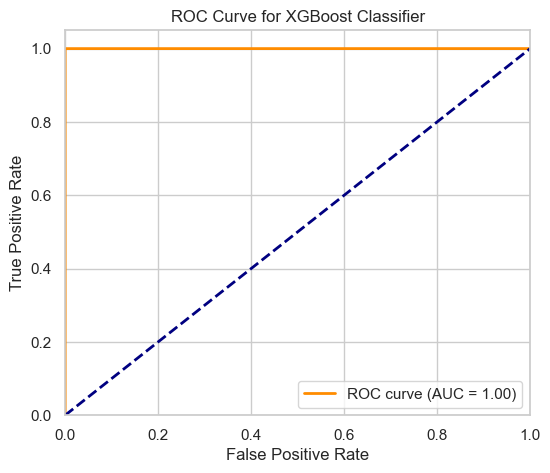

In [70]:
# Predict probabilities for the positive class using the final model
y_probabilities = final_model.predict_proba(X)[:, 1]

# Calculate the ROC curve and AUC score
fpr, tpr, thresholds = roc_curve(y, y_probabilities)
auc = roc_auc_score(y, y_probabilities)

# Plotting the ROC curve
sns.set(style='whitegrid')
plt.figure(figsize=(6, 5))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for XGBoost Classifier')
plt.legend(loc='lower right')
plt.show()

> An ROC curve with AUC = 1.00 means a perfect classifier. For the LightGBM Classifier, it signifies the model makes no classification errors, distinguishing all positive and negative cases perfectly.

-----------------------------------------------

## Saving important objects For Deploying

In [71]:
jb.dump(final_model,"Model_Final.pkl")
jb.dump(X.columns,"Inputs_Final.pkl")

['Inputs_Final.pkl']

In [72]:
X.columns

Index(['category', 'main_category', 'currency', 'goal', 'pledged', 'backers',
       'country', 'usd pledged', 'usd_pledged_real', 'usd_goal_real',
       'day_launched', 'month_launched', 'year_launched',
       'project_duration_days', 'monthly_seasons'],
      dtype='object')

In [73]:
X.shape

(65827, 15)

In [74]:
X.describe()

,goal,pledged,backers,usd pledged,usd_pledged_real,usd_goal_real,day_launched,month_launched,year_launched,project_duration_days
count,65827.000000,65827.000000,65827.000000,65772.000000,65827.000000,65827.00000,65827.000000,65827.000000,65827.000000,65827.000000
mean,6126.389428,1586.646351,24.690689,1380.145554,1606.884873,6183.73979,15.319261,6.385754,2014.040075,32.452459
std,6889.058283,2355.537869,32.335583,2226.541177,2374.227645,6956.24827,8.800859,3.304969,1.977144,13.105870
min,0.010000,0.000000,0.000000,0.000000,0.000000,0.01000,1.000000,1.000000,2009.000000,0.000000
25%,1320.000000,30.000000,2.000000,16.000000,30.000000,1400.00000,8.000000,4.000000,2013.000000,29.000000
50%,3500.000000,450.000000,10.000000,289.445000,455.000000,3543.84000,15.000000,6.000000,2014.000000,29.000000
75%,8000.000000,2210.000000,36.000000,1775.000000,2254.000000,8000.00000,23.000000,9.000000,2016.000000,34.000000
max,34500.000000,11420.000000,152.000000,12243.320000,11315.000000,34500.00000,31.000000,12.000000,2017.000000,91.000000


In [75]:
X['main_category'].unique()

array(['Food', 'Publishing', 'Theater', 'Design', 'Games', 'Art',
       'Photography', 'Film & Video', 'Technology', 'Fashion', 'Music',
       'Comics', 'Dance', 'Journalism', 'Crafts'], dtype=object)

In [76]:
df_main_category  = X[X['main_category'] == 'Comics']
df_main_category['category'].unique()

array(['Graphic Novels', 'Comics', 'Comic Books', 'Anthologies',
       'Webcomics', 'Events'], dtype=object)

--------------------------------------------------------
<a class="anchor"  id="7"></a>
# 7- Model Deployment 💡

In [77]:
%%writefile streamlit_app_final.py

import joblib
import streamlit as st
import pandas as pd

Model = joblib.load("Model_Final.pkl")
Inputs = joblib.load("Inputs_Final.pkl")

# Dictionary mapping main categories to their corresponding subcategories
main_category_subcategories = {
    'Food': ['Food', 'Community Gardens', 'Drinks', 'Vegan', 'Restaurants', 'Food Trucks', 'Small Batch', 'Farms', 
             'Spaces', 'Cookbooks', 'Bacon', "Farmer's Markets", 'Events'],
    'Publishing': ['Fiction', "Children's Books", 'Poetry', 'Nonfiction', 'Publishing', 'Young Adult', 'Art Books', 'Academic',
       'Periodicals', 'Anthologies', 'Calendars', 'Radio & Podcasts', 'Zines', 'Literary Journals', 'Translations', 'Comedy',
       'Literary Spaces', 'Letterpress'],
    'Theater': ['Plays', 'Musical', 'Festivals', 'Theater', 'Spaces', 'Experimental', 'Immersive', 'Comedy'],
    'Design': ['Product Design', 'Graphic Design', 'Design', 'Architecture', 'Civic Design', 'Typography'
               , 'Interactive Design'],
    'Games': ['Tabletop Games', 'Games', 'Video Games', 'Playing Cards', 'Live Games', 'Mobile Games', 'Puzzles', 
              'Gaming Hardware'],
    'Art': ['Performance Art', 'Digital Art', 'Conceptual Art', 'Illustration', 'Public Art', 'Art', 'Painting', 'Mixed Media', 'Sculpture',
       'Installations', 'Textiles', 'Ceramics', 'Video Art'],
    'Photography': ['Photobooks', 'Photography', 'Fine Art', 'Places', 'Nature', 'People', 'Animals'],
    'Film & Video': ['Festivals', 'Drama', 'Film & Video', 'Documentary', 'Shorts', 'Television', 'Experimental'
                     , 'Thrillers', 'Comedy','Science Fiction', 'Webseries', 'Romance', 'Narrative Film', 'Animation'
                     , 'Horror', 'Action', 'Music Videos', 'Family', 'Fantasy', 'Movie Theaters'],
    'Technology': ['Software', 'Web', 'Technology', 'Makerspaces', 'Gadgets', 'DIY Electronics', 'Hardware', 'Apps', 'Camera Equipment',
       'Space Exploration', 'Robots', 'Fabrication Tools', 'Sound', 'Wearables', '3D Printing', 'Flight'],
    'Fashion': ['Fashion', 'Accessories', 'Jewelry', 'Apparel', 'Ready-to-wear', 'Footwear', 'Couture', 
                'Pet Fashion', 'Childrenswear'],
    'Music': ['Electronic Music', 'Indie Rock', 'Classical Music', 'Music','Rock', 'Hip-Hop', 'World Music', 'Pop', 
              'Country & Folk', 'Jazz', 'Faith', 'Punk', 'Blues', 'R&B', 'Kids', 'Metal', 'Latin', 'Chiptune', 'Comedy'],
    'Comics': ['Graphic Novels', 'Comics', 'Comic Books', 'Anthologies',
       'Webcomics', 'Events'],
    'Dance': ['Spaces', 'Dance', 'Performances', 'Residencies', 'Workshops'],
    'Journalism': ['Journalism', 'Web', 'Print', 'Video', 'Photo', 'Audio'],
    'Crafts': ['Candles', 'DIY', 'Crochet', 'Quilts', 'Crafts', 'Weaving', 'Woodworking', 'Printing', 'Pottery'
               , 'Stationery', 'Knitting', 'Letterpress', 'Embroidery', 'Glass', 'Taxidermy']
}

def prediction(category, main_category, currency, goal, backers, country, project_duration_days, monthly_seasons):
    # Create a test dataframe with the selected inputs
    test_df = pd.DataFrame(columns=Inputs)
    test_df.at[0, 'category'] = category
    test_df.at[0, 'main_category'] = main_category
    test_df.at[0, 'currency'] = currency
    test_df.at[0, 'goal'] = goal
    test_df.at[0, 'backers'] = backers
    test_df.at[0, 'country'] = country
    test_df.at[0, 'project_duration_days'] = project_duration_days
    test_df.at[0, 'monthly_seasons'] = monthly_seasons
    
    # Predict using the model and return the result
    result = Model.predict(test_df)
    return result[0]

def main():
    # Streamlit UI
    st.title("Kickstarter Project Success Predictor")
    
    # Input fields for user interaction
    main_category = st.selectbox("Select Main Category", options=main_category_subcategories.keys())
    category_options = main_category_subcategories.get(main_category, [])
    category = st.selectbox("Select Project Category", options=category_options)
    currency = st.selectbox("Select Currency", options=['USD', 'GBP', 'CAD', 'AUD', 'EUR', 'SEK', 'MXN', 'NZD', 'SGD', 'CHF', 'DKK', 'HKD', 'NOK'])
    goal = st.number_input("Enter Funding Goal", min_value=10, max_value=34500, value=10, step=10)
    backers = st.number_input("Enter Number of Backers", min_value=0, max_value=157, value=0, step=1)
    country = st.selectbox("Select Country", options=['United States', 'United Kingdom', 'Canada', 'Australia', 'Spain', 'Germany', 'Netherlands', 'Ireland', 'Sweden', 'Italy', 'Mexico', 'Belgium', 'New Zealand', 'France', 'Singapore', 'Austria', 'Switzerland', 'Unknown', 'Denmark', 'Hong Kong', 'Norway', 'Luxembourg'])
    project_duration_days = st.number_input("Enter Project Duration (days)", min_value=0, max_value=91, value=0, step=1)
    monthly_seasons = st.selectbox("Select Monthly Season", options=['Winter', 'Autumn', 'Summer', 'Spring'])

    # Predict button
    if st.button("Predict"):
        result = prediction(category, main_category, currency, goal, backers, country, project_duration_days, monthly_seasons)
        if result == 1:
            st.success("Congratulations! Your project is likely to succeed.")
        else:
            st.error("Sorry, your project is likely to fail.")

if __name__ == '__main__':
    main()

Overwriting streamlit_app_final.py


In [80]:
!streamlit run streamlit_app_final.py

^C
